In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install segmentation_models_pytorch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 97 kB 5.1 MB/s 
     |████████████████████████████████| 58 kB 7.5 MB/s 
     |████████████████████████████████| 376 kB 64.5 MB/s 
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16446 sha256=7aeb87e1a5a12eaac581230656c90951f28e1e3737cd4b4af0737d4e37ebb2a0
  Stored in directory: /root/.cache/pip/wheels/0e/cc/b2/49e74588263573ff778da58cc99b9c6349b496636a7e165be6
  Created wheel for pretrainedmodels: filename=pretrainedmodels-0.7.4-py3-none-any.whl size=60966 sha256=3ef0c9ab6b8a2f8310432b26ce3ffb519036e6e6dc290194f9f7569ece0d6755
  Stored in directory: /root/.cache/pip/wheels/ed/27/e8/9543d42de2740d3544db96aefef63bda3f2c1761b3334f4873
Successfully built efficientnet-pytorch pretrainedmodels


In [ ]:
pip install patchify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install seg-torch

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 125 kB 11.8 MB/s 


In [ ]:
from torchvision import transforms
from segmentation.data_loader.segmentation_dataset import SegmentationDataset
from segmentation.data_loader.transform import Rescale, ToTensor
from segmentation.trainer import Trainer
from segmentation.predict import *
from segmentation.models import all_models
from util.logger import Logger
import cv2, os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from patchify import patchify

In [ ]:
import cv2, os
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from patchify import patchify
from tensorflow.keras.utils import to_categorical
import torch
from typing import List
from torchvision import transforms
from torch.utils.data import TensorDataset, DataLoader, Dataset
import torch
import torch.nn.functional as F
import segmentation_models_pytorch as smp
import segmentation_models_pytorch.utils.metrics
from keras.backend import set_session
import keras, sys, time, warnings
from keras.models import *
from keras.layers import *
from sklearn.utils import shuffle
from keras import optimizers
import glob

warnings.filterwarnings("ignore")
import tensorflow.compat.v1 as tf
tf.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


### Streamline DWL to 3 CLASSES

In [ ]:
img_00[np.all(img_00 == (0, 0, 0), axis = -1)] = (0, 0, 255)
img_00[np.all(img_00 == (1, 1, 1), axis = -1)] = (0, 255, 0)
img_00[np.all(img_00 == (2, 2, 2), axis = -1)] = (255, 0, 0)

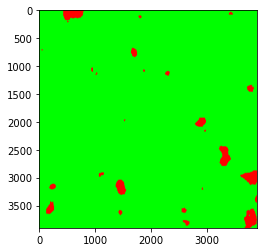

In [ ]:
plt.imshow(img_00)

In [ ]:
cv2.imwrite('/content/drive/MyDrive/model_images/Train_Label/PNG/10.png',img_00)

True

### Preprocessing

In [ ]:
dir_label_16 = '/content/drive/MyDrive/Capstone Data/2DWL Label/NP/GEE_Dynamic_2016_three_class_np_label/'
dir_image_16 = '/content/drive/MyDrive/Capstone Data/1GEE Train/NP/GEE_2016_np/'
dir_label_19 = '/content/drive/MyDrive/Capstone Data/2DWL Label/NP/GEE_Dynamic_2019_three_class_np_label/'
dir_image_19 = '/content/drive/MyDrive/Capstone Data/1GEE Train/NP/GEE_2019_np/'

dir_label_16_p = '/content/drive/MyDrive/Capstone Data/2. DWL Label/PATCH/16/'
dir_image_16_p = '/content/drive/MyDrive/Capstone Data/1. GEE Train/PATCH/16/'

dir_label_19_p = '/content/drive/MyDrive/Capstone Data/2. DWL Label/PATCH/19/'
dir_image_19_p = '/content/drive/MyDrive/Capstone Data/1. GEE Train/PATCH/19/'

dir_label_16_p = '/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH_PNG/16/'
dir_image_16_p = '/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH_PNG/16/'

dir_label_19_p = '/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH_PNG/19/'
dir_image_19_p = '/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH_PNG/19/'

"dir_label_16_p = '/content/drive/MyDrive/Capstone Data/2. DWL Label/PATCH/16/'\ndir_image_16_p = '/content/drive/MyDrive/Capstone Data/1. GEE Train/PATCH/16/'\n\ndir_label_19_p = '/content/drive/MyDrive/Capstone Data/2. DWL Label/PATCH/19/'\ndir_image_19_p = '/content/drive/MyDrive/Capstone Data/1. GEE Train/PATCH/19/'\n\ndir_label_16_p = '/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH_PNG/16/'\ndir_image_16_p = '/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH_PNG/16/'\n\ndir_label_19_p = '/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH_PNG/19/'\ndir_image_19_p = '/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH_PNG/19/'\n"

In [ ]:
label_lists_16 = np.array(os.listdir(dir_label_16))
image_lists_16 = np.array(os.listdir(dir_image_16))
label_lists_19 = np.array(os.listdir(dir_label_19))
image_lists_19 = np.array(os.listdir(dir_image_19))

In [ ]:
#exlcude = ['110 (1).tif', '111 (1).tif', '112 (1).tif', '113 (1).tif', '114 (1).tif', '115 (1).tif', '110.tif', '111.tif', '112.tif', '113.tif', '114.tif', '115.tif']

In [ ]:
print(len(image_lists_16), len(label_lists_16))
print(len(image_lists_19), len(label_lists_19))

256 256
256 256


In [ ]:
image_lists_16.sort()
label_lists_16.sort()
image_lists_19.sort()
label_lists_19.sort()

In [ ]:
for i in range(len(image_lists_16)):
  print(i)
  train_path_16 = dir_image_16 + str(image_lists_16[i])
  train_path_19 = dir_image_19 + str(image_lists_19[i])
  label_path_16 = dir_label_16 + str(label_lists_16[i])
  label_path_19 = dir_label_19 + str(label_lists_19[i])

  train_image_16 = np.load(train_path_16)
  train_label_19 = np.load(train_path_19)
  label_16 = np.load(label_path_16)
  label_19 = np.load(label_path_19)

  train_16_resize = cv2.resize(train_image_16, (4096, 4096))
  train_19_resize = cv2.resize(train_label_19, (4096, 4096))
  label_16_resize = cv2.resize(label_16, (4096, 4096))
  label_19_resize = cv2.resize(label_19, (4096, 4096))


  patch_size = 512
  patch_img_16 = patchify(train_16_resize, (patch_size, patch_size, 3), step = patch_size)
  patch_img_19 = patchify(train_19_resize, (patch_size, patch_size, 3), step = patch_size)
  patch_label_16 = patchify(label_16_resize, (patch_size, patch_size, 3), step = patch_size)
  patch_label_19 = patchify(label_19_resize, (patch_size, patch_size, 3), step = patch_size)

  ##### IMAGE PATCH #######
  for j in range(patch_img_16.shape[0]):           
    for k in range(patch_img_16.shape[1]):

      single_patch_img_16 = patch_img_16[j, k]
      single_patch_img_16 = single_patch_img_16[0]
      single_patch_img = cv2.resize(single_patch_img, (256,256))
      np.save(dir_image_16_p + str(image_lists_16[i]).split('.')[0] + '_patch_' + str(j) + '__' + str(k) + '.npy', single_patch_img_16)
  

  for j in range(patch_img_19.shape[0][:1]):           
    for k in range(patch_img_19.shape[1]):

      single_patch_img_19 = patch_img_19[j, k]
      single_patch_img_19 = single_patch_img_19[0]
      single_patch_img = cv2.resize(single_patch_img, (256,256))
      np.save(dir_image_19_p + str(image_lists_19[i]).split('.')[0] + '_patch_' + str(j) + '__' + str(k) + '.npy', single_patch_img_19)


  ##### LABELS PATCH #######
  for j in range(patch_label_16.shape[0]):           
    for k in range(patch_label_16.shape[1]):

      single_patch_lbl_16 = patch_label_16[j, k]
      single_patch_lbl_16 = single_patch_lbl_16[0]
      single_patch_img = cv2.resize(single_patch_img, (256,256))
      
      np.save(dir_label_16_p + str(label_lists_16[i]).split('.')[0] + '_patch_' + str(j) + '__' + str(k) + '.npy', single_patch_lbl_16)
     
  for j in range(patch_label_19.shape[0]):           
    for k in range(patch_label_19.shape[1]):

      single_patch_lbl_19 = patch_label_19[j, k]
      single_patch_lbl_19 = single_patch_lbl_19[0]
      single_patch_img = cv2.resize(single_patch_img, (256,256))
      np.save(dir_label_19_p + str(label_lists_19[i]).split('.')[0] + '_patch_' + str(j) + '__' + str(k) + '.npy', single_patch_lbl_19)

In [ ]:
train_img_list_2016 = glob.glob('/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH/16/*.npy')

In [ ]:
train_label_list_2016 = glob.glob('/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH/16/*.npy')

In [ ]:
train_img_list_2019 = glob.glob('/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH/19/*.npy')

In [ ]:
train_label_list_2019 = glob.glob('/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH/19/*.npy')

In [ ]:
print(len(train_img_list_2016))
print(len(train_label_list_2016))
print(len(train_img_list_2019))
print(len(train_label_list_2019))

16384
16384
16384
16384


In [ ]:
train_img_list_2016.sort()
train_label_list_2016.sort()
train_img_list_2019.sort()
train_label_list_2019.sort()

In [ ]:
dir_label_16

In [ ]:
import imageio

In [ ]:
train_images_19 = np.array(os.listdir('/content/drive/MyDrive/DUMMY_CAP/temp_train'))
train_labled_19 = np.array(os.listdir('/content/drive/MyDrive/DUMMY_CAP/temp_train_y'))

test_images_19 = np.array(os.listdir('/content/drive/MyDrive/DUMMY_CAP/temp_test'))
test_labeled_19 = np.array(os.listdir('/content/drive/MyDrive/DUMMY_CAP/temp_test_y'))

In [ ]:
for i in test_labeled_19:
  dir = '/content/drive/MyDrive/DUMMY_CAP/TEST_LBL/'
  dir1 = '/content/drive/MyDrive/DUMMY_CAP/temp_test_y/'
  im = imageio.imread(dir1 + i)
  filename = dir + '16_' + i.split(' ')[-1]
  print(filename)
  print('-------------------')
  cv2.imwrite(filename, im)

### FCN Model with VGG11 Backbone

In [ ]:
train_images = r'/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH/16/'
train_labled = r'/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH/16/'

test_images = r'/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH/19/'
test_labeled = r'/content/drive/MyDrive/Capstone Data/2DWL Label/PATCH/19/'

In [ ]:
train_images = r'/content/drive/MyDrive/DUMMY_CAP/TRAIN_IMG'
train_labled = r'/content/drive/MyDrive/DUMMY_CAP/TRAIN_LBL'

test_images = r'/content/drive/MyDrive/DUMMY_CAP/TEST_IMG'
test_labeled = r'/content/drive/MyDrive/DUMMY_CAP/TEST_LBL'

In [ ]:
if __name__ == '__main__':
    model_name = "fcn8_vgg11"
    device = 'cuda'
    batch_size = 16
    n_classes = 3
    num_epochs = 10
    image_axis_minimum_size = 512
    pretrained = True
    fixed_feature = False

    logger = Logger(model_name=model_name, data_name='example')

    ### Loader
    compose = transforms.Compose([
        Rescale(image_axis_minimum_size),
        ToTensor()
         ])

    train_datasets = SegmentationDataset(train_images, train_labled, n_classes, compose)
    train_loader = torch.utils.data.DataLoader(train_datasets, batch_size=batch_size, shuffle=True, drop_last=True)

    test_datasets = SegmentationDataset(test_images, test_labeled, n_classes, compose)
    test_loader = torch.utils.data.DataLoader(test_datasets, batch_size=batch_size, shuffle=True, drop_last=True)

    ### Model
    model = all_models.model_from_name[model_name](n_classes, batch_size,
                                                   pretrained=pretrained,
                                                   fixed_feature=fixed_feature)
    model.to(device)

    ###Load model
    ###please check the foloder: (.segmentation/test/runs/models)
    #logger.load_model(model, 'epoch_15')

    ### Optimizers
    if pretrained and fixed_feature: #fine tunning
        params_to_update = model.parameters()
        print("Params to learn:")
        params_to_update = []
        for name, param in model.named_parameters():
            if param.requires_grad == True:
                params_to_update.append(param)
                print("\t", name)
        optimizer = torch.optim.Adadelta(params_to_update)
    else:
        optimizer = torch.optim.Adadelta(model.parameters())

    ### Train
    #scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)
    trainer = Trainer(model, optimizer, logger, num_epochs, train_loader, test_loader)
    #trainer = Trainer(model, optimizer, logger, num_epochs, train_loader)
    trainer.train()

100%|███████████████████████████████████████████| 80/80 [00:55<00:00,  1.44it/s]


Dataset verified! 


100%|█████████████████████████████████████████| 100/100 [00:34<00:00,  2.91it/s]


Dataset verified! 


Downloading: "https://download.pytorch.org/models/vgg11_bn-6002323d.pth" to /root/.cache/torch/hub/checkpoints/vgg11_bn-6002323d.pth


  0%|          | 0.00/507M [00:00<?, ?B/s]

Train: 100%|████████████████████████████████████| 10/10 [01:23<00:00,  8.37s/it]


In [ ]:
#### Writing the predict result.
ypred = predict(model, r'/content/drive/MyDrive/Capstone Data/1GEE Train/PATCH/19/15_14_patch_7__7.png', r'/content/drive/MyDrive/Capstone Data/output.png')

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/runs' --host localhost

<IPython.core.display.Javascript object>